---

<center><h2>Cargar librerias</h2></center>

---

In [1]:
import os
import skimage
import pandas as pd
import numpy as np
import cv2
import nevergrad as ng
import time as tm
import seaborn as sns
import requests

import matplotlib.pyplot as plt
#import albumentations as A
from sklearn.decomposition import PCA

from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.cluster import KMeans, SpectralClustering, AgglomerativeClustering, DBSCAN
from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import Isomap, TSNE

from IPython.display import HTML, display_html, display

import warnings
warnings.filterwarnings('ignore')

---

<center><h2>Leer imagenes</h2></center>

---

In [2]:
#
# Toma el path del directorio con las imagenes
#
def read_folder(path):
    files = [ os.path.join(path, file) for file in os.listdir(path) if file.endswith(".jpg") ]
    return files

def to_imgs(imgs):
    return [cv2.imread(x) for x in imgs]

X_files = read_folder("../zip/train/")
Y_files = read_folder("../zip/test/")
Y_files = sorted(Y_files, key=lambda name: int(name.split("/")[-1][:-4])) # Para que esten en el mismo orden que y_clusters

X = to_imgs(X_files)
Y = to_imgs(Y_files)

Y_orig = [ y.copy() for y in Y ]

# Clusters a los que corresponden cada carta en train y test
x_clusters_text = requests.get("https://raw.githubusercontent.com/Villainnumber1/ML_files/main/train_clusters.txt").text
y_clusters_text = requests.get("https://raw.githubusercontent.com/Villainnumber1/ML_files/main/test_clusters.txt").text
x_clusters = [ int(x) for x in x_clusters_text.split(", ") ]
y_clusters = [ int(y) for y in y_clusters_text.split(", ") ]

In [3]:
######################
# Plotting functions #
######################

# Plotear imagen
def plot_image(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    skimage.io.imshow(img)

# Plotear una comparacion de dos sets de imagenes, row es la fila a plotear
def plot_comparison(imgs1, imgs2, row=0):
  fig, axs = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

  for x in range(5):
    img = cv2.cvtColor(imgs1[row*10 + x], cv2.COLOR_BGR2RGB)
    axs[0][x].imshow(img)
 
  for x in range(5):
    img = cv2.cvtColor(imgs2[row*10 + x], cv2.COLOR_BGR2RGB)
    axs[1][x].imshow(img)

# Plotear 10 filas
def plot_2_rows(imgs):
    rows, cols = 2, 10
    fig, axs = plt.subplots(rows, cols, figsize=(30, 5))
    
    for y in range(rows):
        for x in range(cols):
            img = cv2.cvtColor(imgs[y*10 + x], cv2.COLOR_BGR2RGB)
            axs[y][x].imshow(img)

---

<center><h2>El problema</h2></center>

---

Tenemos un conjunto de alrededor de 7892 cartas y nos piden que clasifiquemos otras 268 cartas por su palo que puede ser treboles, picas, corazones, diamantes y joker.<br>
En el conjunto de test nos encontramos que hay 65 cartas de cada palo y 5 jokers. Nos piden que hagamos entrenamiento no supervisado por lo cual no podemos añadir tags<br>
al conjunto de train.

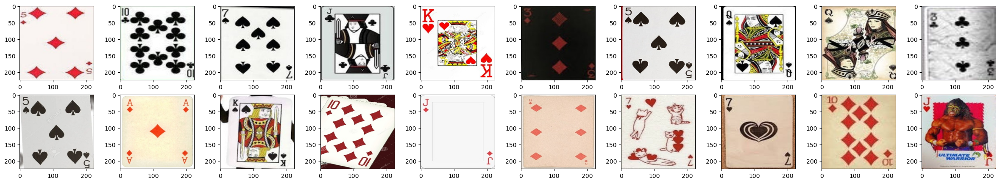

In [4]:
plot_2_rows(X[650:])

---

<center><h2>Analisis de datos</h2></center>

---

En esta entrega se mantiene más que en ninguna de las tres anteriores el principio GIGO, Garbage In Garbage Out.<br>

Podemos observar que algunas cartas están torcidas:

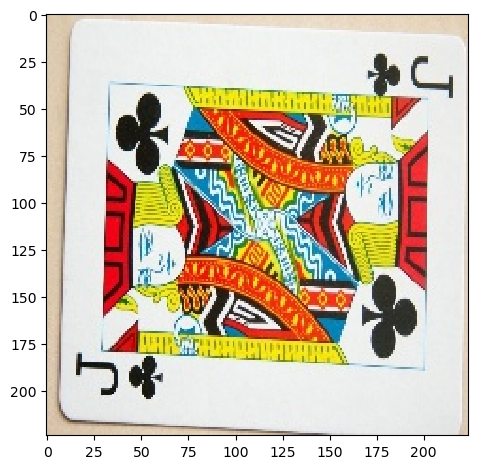

In [5]:
plot_image(X[36])

O incluso tienen un ángulo diferente:

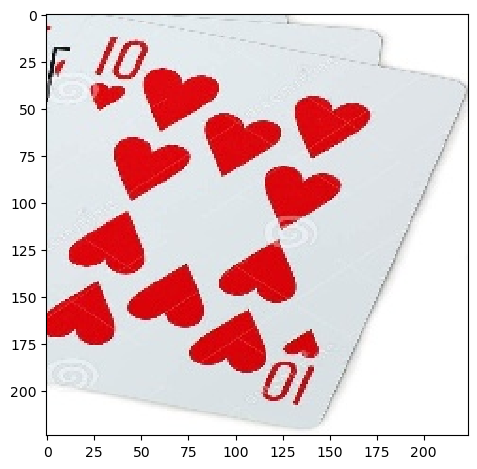

In [6]:
plot_image(X[6])

Otras de las cartas tienen una cantidad bastante grande de ruido:

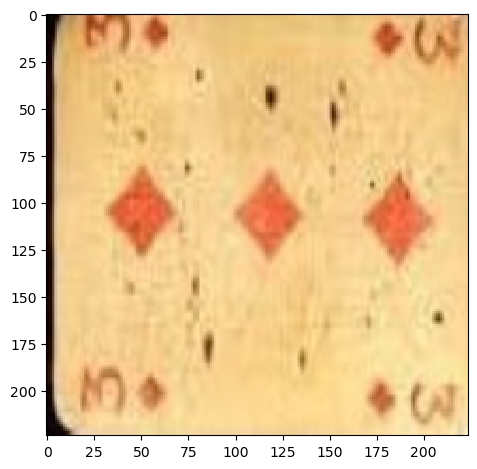

In [7]:
plot_image(X[4])

Otros de los factores que hemos podido observar es cartas en blanco y negro, de palos diferentes, símbolos extraños, alejadas de la cámara, etc.<br>

No hemos podido observar que cantidad de ellas son de buena calidad ya que el dataset es bastante grande y solamente<br>
identificar el palo del conjunto de test para calcular el ARI nos ha llevado bastante tiempo. Si hubiesemos tenido<br>
más tiempo podría haber estado interesante observar la representación que tiene cada "tipo" de carta y cuanto influye<br>
en la capacidad de generalización del modelo. Una manera de manejar este problema es añadir cartas mediante Data Augmentation<br>
añadiendo cartas giradas en diferentes ángulos, más ruido gaussiano, etc.

También hemos hecho una nube de puntos con los dos componentes principales de las primeras 200 cartas del conjunto de train:

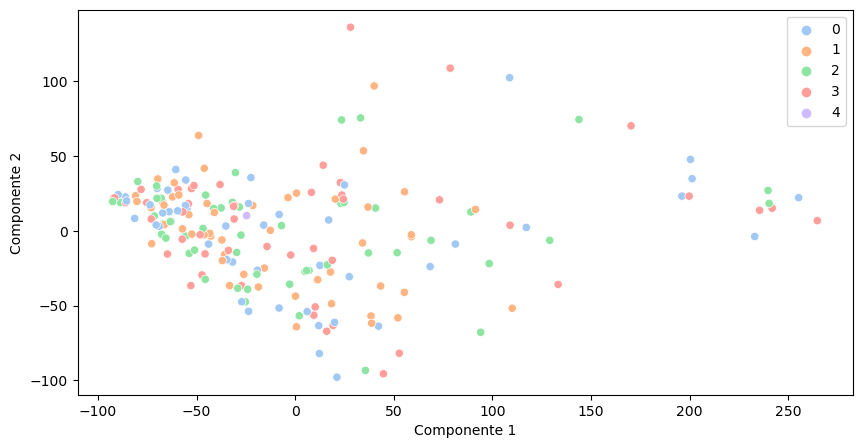

In [8]:
def plot_cluster_clouds(imgs_flat, pred):
    import seaborn as sns
    pca = PCA(n_components=2)
    
    imgs_2d = pca.fit_transform(imgs_flat)
    
    fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(10, 5))
    ax = sns.scatterplot(x=imgs_2d[:,0], y=imgs_2d[:,1], palette="pastel", hue=pred, ax=ax)
    ax.set(xlabel="Componente 1", ylabel="Componente 2")

plot_cluster_clouds([_.flatten()/255 for _ in X[:200]], x_clusters)

---

<center><h2>Preprocesamiento de imagenes</h2></center>

---

Para preprocesar las imágenes hemos creado una pipeline con encadenamiento de métodos para las diferentes transformaciones que podíamos realizar sobre una imagen,<br>
esto nos ha ayudado a poder probar nuevas combinaciones y parámetros de forma más rápida.

También como veremos más adelante nos ha permitido hacer una búsqueda de parámetros para las funciones. Hemos dejado las que hemos usado para la entrega,<br>
pero hemos usado más como conversión a gris (peor) resultado que HSV, segmentación, eliminar backgrounds, sobel, opening, etc.

Este es el procedimiento que mejor resultado nos ha dado:

**1. Data Augmentation:** Añadimos imagenes girada n grados para mejorar la capacidad de generalización del modelo. Hemos usado librerias como Albumentations<br>
con métodos estocásticos sin un buen resultado.

In [9]:
def rotate(img, degrees=90, zoom=1.0):
    M = cv2.getRotationMatrix2D((112, 112), -degrees, zoom)
    return cv2.warpAffine(img, M, (224, 224))

def augmentate_dataset(imgs, n_cards=200):
    return [ rotate(img) for img in imgs[:n_cards] ]

X += augmentate_dataset(X, n_cards=200)

**2. Convertir el color negro a blanco si las imagenes son mayormente negras**

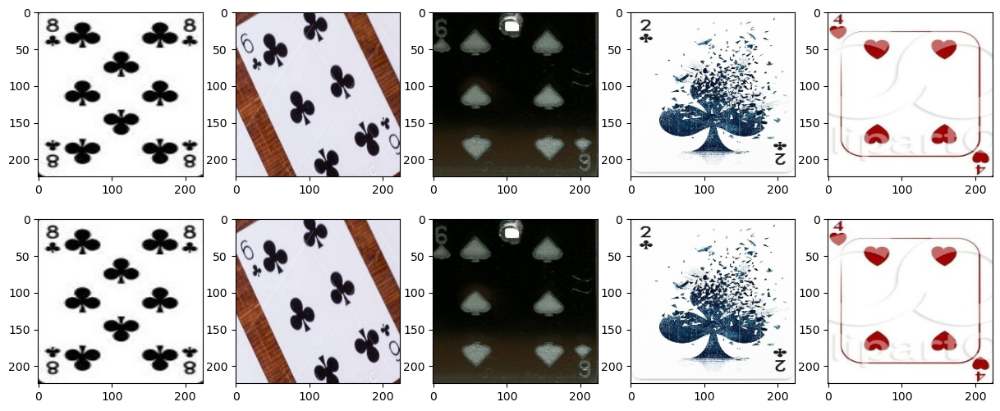

In [10]:
def to_white_if_black(_img):
    n_black = 0
    img = _img.copy()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    if cv2.countNonZero(gray) < 30000:
        black_pixels = np.where(
            (img[:, :, 0] < 50) & 
            (img[:, :, 1] < 50) & 
            (img[:, :, 2] < 50)
        )

        img[black_pixels] = [255, 255, 255]
        
    return img
    
_X = [ to_white_if_black(img) for img in X ]
_Y = [ to_white_if_black(img) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**3. Redimensionar la imagen:** Redimensionamos las imagenes de 224x224 a 110x110 para que las operaciones se realizen<br>
más rápidamente. Hemos encontrado que no se produce un impacto negativo al hacer la redimensión al principio con respecto<br>
al final. Hacer los pasos más rápidos también nos ayuda con nevergrad.

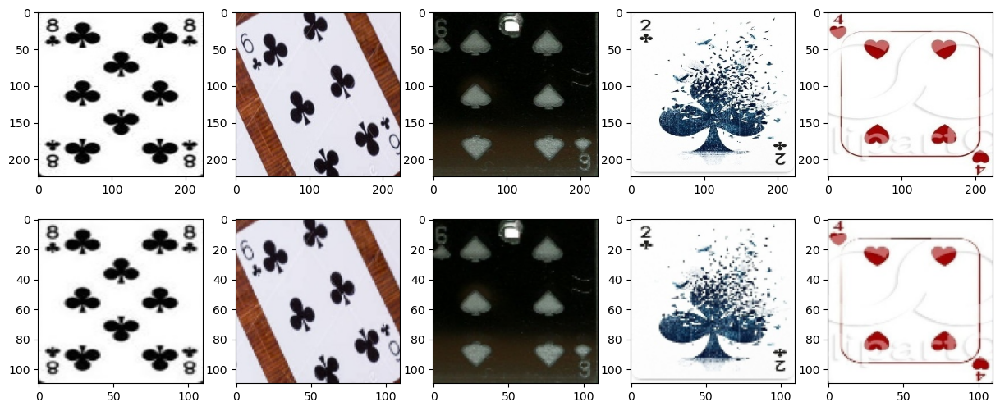

In [11]:
size = 110

_X = [ cv2.resize(img, (size, size)) for img in X ]
_Y = [ cv2.resize(img, (size, size)) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**4. Blur:** Hacemos blur gaussiano para eliminar ruido de la imagen.

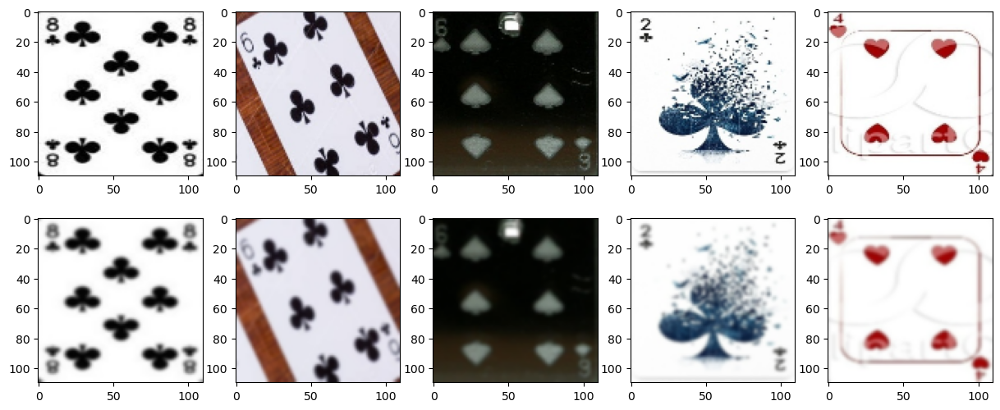

In [12]:
_X = [ cv2.GaussianBlur(img, (5, 5), 0) for img in X ]
_Y = [ cv2.GaussianBlur(img, (5, 5), 0) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**5. Erode:** Reducimos el tamaño de las líneas de la imagen para mejorar la identificación de la ROI.

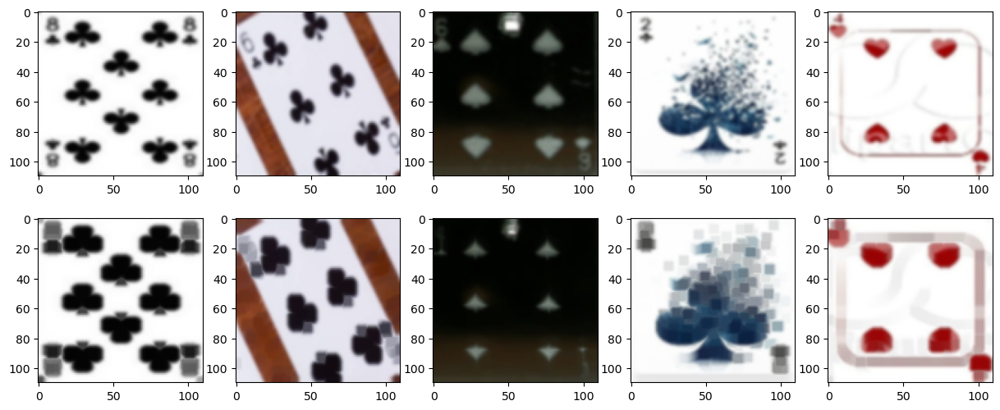

In [13]:
def erode(img):
    kernel = np.ones((5, 5), np.uint8)
    return cv2.erode(img, kernel, iterations=1)

_X = [ erode(img) for img in X ]
_Y = [ erode(img) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**6. Igualar histograma:** Igualamos el rango de intensidad de las imágenes para que se realzen las feature más importantes.

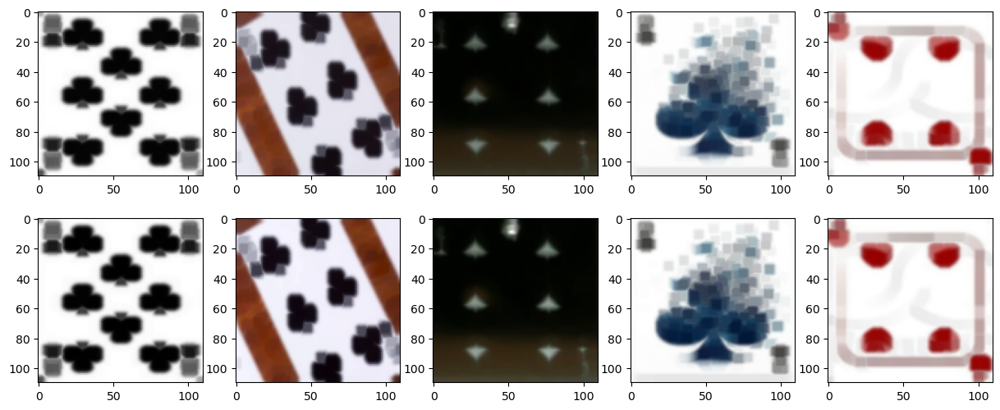

In [14]:
def equalize_histogram(img):
    percentile_2, percentile_98 = np.percentile(img, (0, 100))
    return skimage.exposure.rescale_intensity(img, in_range=(percentile_2, percentile_98))

_X = [ equalize_histogram(img) for img in X ]
_Y = [ equalize_histogram(img) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**7. Segundo blur:** Hacemos blur de nuevo.

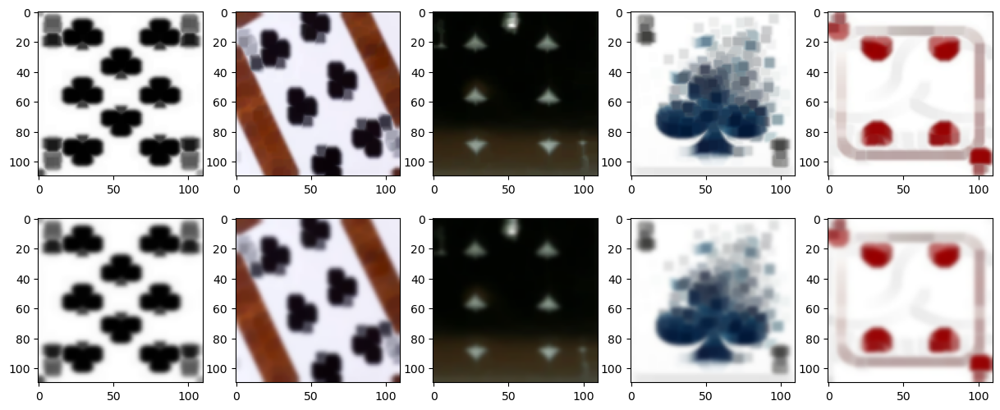

In [15]:
_X = [ cv2.GaussianBlur(img, (5, 5), 0) for img in X ]
_Y = [ cv2.GaussianBlur(img, (5, 5), 0) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**8. Quitar canal verde**: Quitamos el canal verde ya que la gran mayoría de las imágenes son simplemente identificables con los canales rojo y azul.

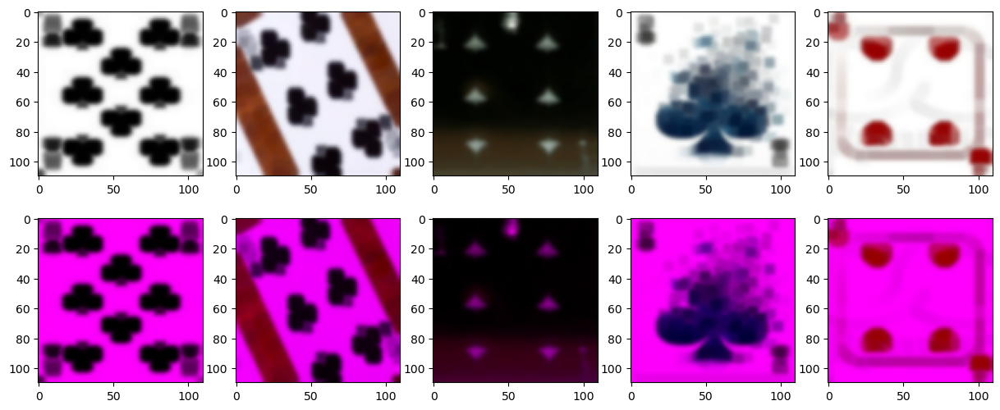

In [16]:
CHANNEL_B, CHANNEL_G, CHANNEL_R = 0, 1, 2

def remove_channel(_img, channel):
    img = _img.copy()
    img[:,:,channel] = np.zeros([img.shape[0], img.shape[1]])
    return img

_X = [ remove_channel(img, CHANNEL_G) for img in X ]
_Y = [ remove_channel(img, CHANNEL_G) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**9. Recortar la región de interés:** Usamos el método del threshold para recortar la región de interés que esté más arriba a la izquierda<br>
sin contar con la ROI que corresponde a la imagen entera. Si no se encuentra ninguna ROI se recorta la porción de w x h correspondiente al<br>
recuadro superior izquierdo de la imagen.

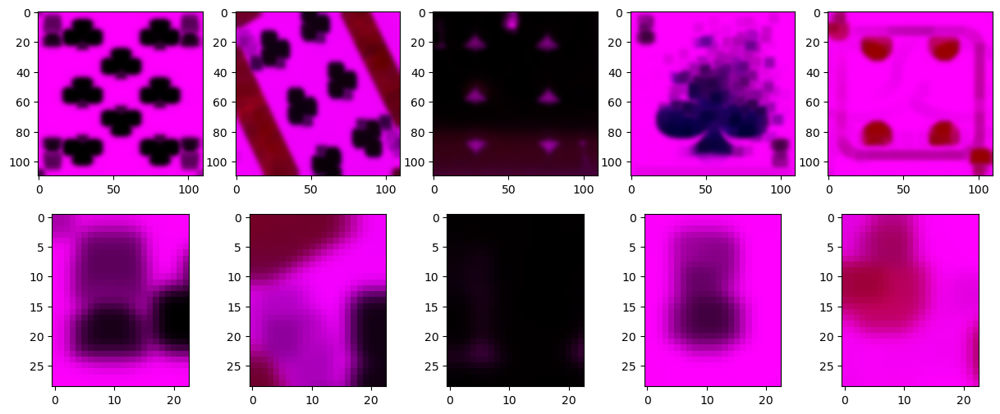

In [17]:
def crop(img, x1, x2, y1, y2):
    return img[y1:y2, x1:x2]

def crop_roi(img, _h, _w):
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    im_gauss = cv2.GaussianBlur(gray_img, (5, 5), 0)
    ret, thresh = cv2.threshold(im_gauss, 127, 255, 0)

    contours,hierarchy = cv2.findContours(thresh, 1, 2)

    rects = []
    for contour in contours[1:]:
        area=cv2.contourArea(contour)
        if area>=200:
            x,y,w,h=cv2.boundingRect(contour)
            rects.append((x, y, w, h))

    # Ordenar por posicion
    rects = sorted(rects, key=lambda t: t[0]+t[1])

    # No ha encontrado ninguna ROI
    if not rects:
        return crop(img, 0, _h, 0, _w)
    else:
        x, y, _, _ = rects[0]

        while y+_h >= 223: y -= 1
        while x+_w >= 223: x -= 1

        # Ha encontrado una ROI
        if y <= 0 or x <= 0:
            return crop(img, 0, _h, 0, _w)
        else:
            return img[y:y+_h, x:x+_w]

roi_h, roi_w = 23, 29

_X = [ crop_roi(img, _h=roi_h, _w=roi_w) for img in X ]
_Y = [ crop_roi(img, _h=roi_h, _w=roi_w) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**10. Convertir imagen a espacio HSV** Convirtiendo la imagen de BGR a HSV conseguimos ayudar a resaltar las feature más importantes de la imagen y<br>
oscurecer las partes que menos relevancia tienen.

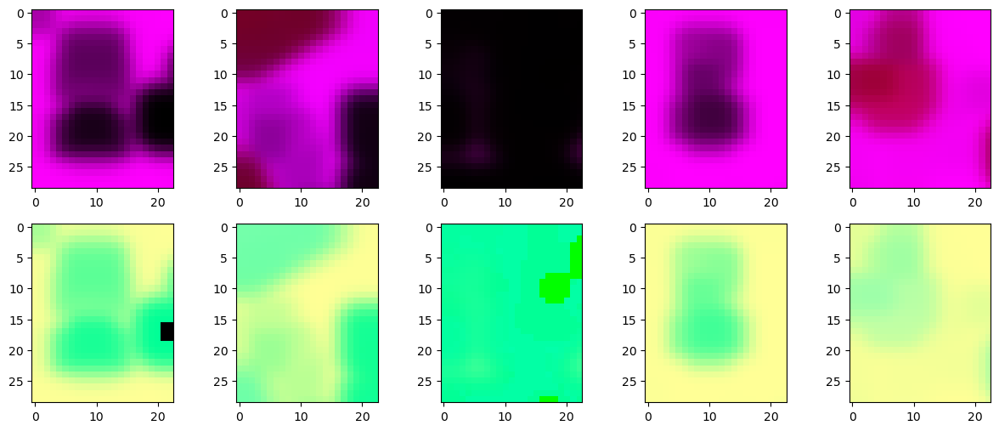

In [18]:
_X = [ cv2.cvtColor(img, cv2.COLOR_BGR2HSV) for img in X ]
_Y = [ cv2.cvtColor(img, cv2.COLOR_BGR2HSV) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

**11. Segundo erode** Hacemos erode de nuevo.

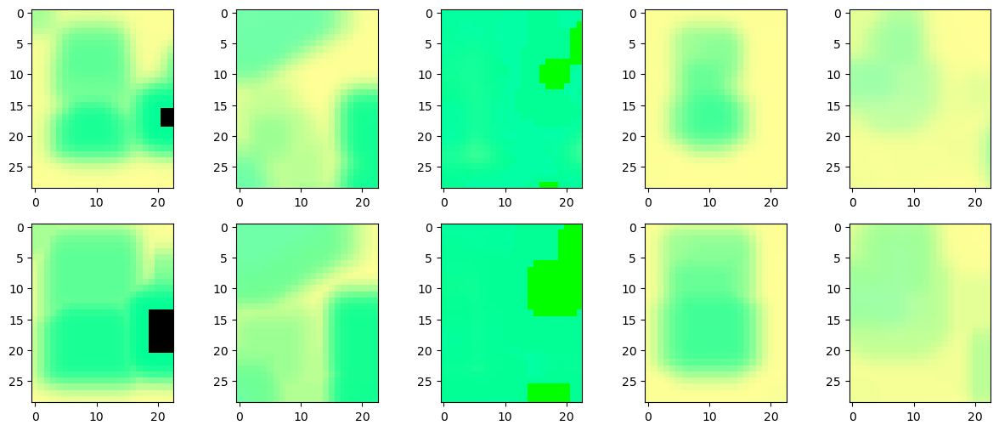

In [19]:
def erode(img):
    kernel = np.ones((5, 5), np.uint8)
    return cv2.erode(img, kernel, iterations=1)

_X = [ erode(img) for img in X ]
_Y = [ erode(img) for img in Y ]

plot_comparison(X, _X, row=2)
X, Y = _X, _Y

---------
Análisis de componentes
---------

Una vez realizada la transformación tenemos imagenes con alrededor de 28*24*3=2016 features. No son muchas de por si, pero comprobamos el número de componentes<br>
que serían necesarios para explicar un 99.9% de la varianza.

Numero de features para explicar un 50.0% de la varianza: 1
Numero de features para explicar un 75.0% de la varianza: 5
Numero de features para explicar un 90.0% de la varianza: 16
Numero de features para explicar un 99.0% de la varianza: 169
Numero de features para explicar un 99.9% de la varianza: 575
Numero de features para explicar un 99.99% de la varianza: 1027



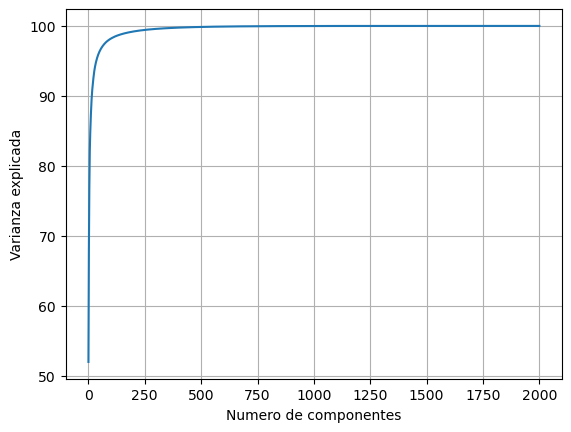

In [20]:
def feature_n_for_explained_variance_ratio(pca, ratio):
    total = 0
    
    for i, n in enumerate(pca.explained_variance_ratio_):
        total += n
        
        if total >= ratio:
            return i+1
    
    return -1

x = [ _.flatten() for _ in X ]

# Dibuja la curva de varianza de PCA
pca = PCA()

pca.fit_transform(x)

plt.grid()
plt.plot(np.cumsum(pca.explained_variance_ratio_ * 100))
plt.xlabel('Numero de componentes')
plt.ylabel('Varianza explicada')

for n in (0.5, 0.75, 0.9, 0.99, 0.999, 0.9999):
    print("Numero de features para explicar un " + str(n*100) + "% de la varianza:",
          feature_n_for_explained_variance_ratio(pca, n))
print()

Por lo cual podemos ver que podríamos pasar de 2016 features a alrededor de 575 features sin perder mucha información. Como veremos más tarde,<br>
nos vamos a quedar con PCA porque el tiempo de ejecución es muy pequeño y nos daba mejores resultados que con otros algoritmos de reducción<br>
dimensional.

---

<center><h2>Reducción Dimensional</h2></center>

---

Intentamos identificar y eliminar las características que disminuyen el rendimiento del modelo para lo cual aplicamos reducción dimensional.<br>
Hemos encontrado que los tiempos en general se han visto perjudicados, pensabamos que al utilizar un algoritmo especializado en reducción dimensional<br>
el tiempo total con el clustering se rediciría pero al final la suma de tiempos empleados se vieron incrementados y no merecía la pena seguir con ellos<br>
debido a los resultados que proporcionaba (con la excepción que hemos comentado antes).<br>

Además, algoritmos como isomap tardan demasiado y consumen muchos recursos de los cuales no disponemos teniendo en cuenta que tampoco mejoraba<br>
los resultados.

# Algoritmos utilizados

1.   Principal Component Analysis (PCA)
2.   Truncated SVD
3.   t-SNE
4.   ISOMAP

In [21]:
def do_pca(X, Y):
    timeAux = tm.time()
    
    pca = PCA(n_components=0.9) # La cantidad de varianza que ha aumentado un poco el resultado

    x_imgs = [(img.astype(np.uint8)/255).flatten() for img in X]
    y_imgs = [(img.astype(np.uint8)/255).flatten() for img in Y]

    pca.fit(x_imgs)

    X_flat = pca.transform(x_imgs)
    Y_flat = pca.transform(y_imgs)
    
    time_PCA = tm.time() - timeAux
    
    return X_flat, Y_flat, time_PCA

In [22]:
def do_TSVD(X, Y):
    timeAux = tm.time()
    
    svd = TruncatedSVD(n_components=200, random_state=42) 

    x_imgs = [(img.astype(np.uint8)/255).flatten() for img in X]
    y_imgs = [(img.astype(np.uint8)/255).flatten() for img in Y]

    svd.fit(x_imgs)

    X_flat = svd.transform(x_imgs)
    Y_flat = svd.transform(y_imgs)
    
    time_TSVD = tm.time() - timeAux
    
    return X_flat, Y_flat, time_TSVD

In [23]:
def do_tsne(X, Y):
    timeAux = tm.time()
    
    tsne = TSNE(perplexity = 15, n_jobs = -1)

    x_imgs = [(img.astype(np.uint8)/255).flatten() for img in X]
    y_imgs = [(img.astype(np.uint8)/255).flatten() for img in Y]

    X_flat = tsne.fit_transform(np.array(x_imgs))
    Y_flat = tsne.fit_transform(np.array(y_imgs))

    time_TSNE = tm.time() - timeAux
    
    return X_flat, Y_flat, time_TSNE

In [24]:
def do_isomap(X, Y):
    timeAux = tm.time()
        
    isomap = Isomap(n_neighbors=30)

    x_imgs = [(img.astype(np.uint8)/255).flatten() for img in X]
    y_imgs = [(img.astype(np.uint8)/255).flatten() for img in Y]

    isomap.fit(x_imgs)

    X_flat = isomap.transform(x_imgs)
    Y_flat = isomap.transform(y_imgs)
      
    time_ISO = tm.time() - timeAux
    
    #print ("Tiempo de ejecución ISOMAP: ", time_ISO)

    return X_flat, Y_flat, time_ISO

---

<center><h2>Ajustando los parámetros para el preprocesamiento</h2></center>

---

Hemos usado Nevergrad para optimizar las diferentes convinaciones de tamaños, valor de difuminzación, valor de la función crop y del resize. También probamos el número de cartas que<br>
utilizamos para la transformación, que vamos variando buscando al mejor ARI. <br>

Este es un pipeline mediante concatenación de métodos que utilizamos durante la elaboración de la práctica para poder permutar métodos de transformación manualmente<br>
y poder ajustar parámetros de forma más sencilla.

In [25]:
############################
# Transformation functions #
############################
class Transformator:
    def __init__(self, img):
        self.img = img.copy()

    ################
    # Color spaces #
    ################
    def bgr_to_grayscale(self):
        self.img = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)
        
        return self
    
    def bgr_to_hsv(self):
        self.img = cv2.cvtColor(self.img, cv2.COLOR_BGR2HSV)
        
        return self
    
    def blur(self, val=(5, 5)):
        self.img = cv2.GaussianBlur(self.img, val, 0) # Parece funcionar bien
        
        return self
        
    def increase_contrast_brightness(self, contrast=1.0, brightness=0.0):
        self.img = contrast*self.img + brightness
        
        return self

    def equalize_histogram(self):
        # Contrast stretching
        percentile_2, percentile_98 = np.percentile(self.img, (0, 100))
        self.img = skimage.exposure.rescale_intensity(self.img, in_range=(percentile_2, percentile_98))
        
        return self
    
    def resize(self, h=100, w=100):
        self.img = cv2.resize(self.img, (w, h)) 
        
        return self
    
    def remove_channel(self, channel=2):
        self.img[:,:,channel] = np.zeros([self.img.shape[0], self.img.shape[1]])
        
        return self
    
    def invert_if_black(self):
        gray = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)

        if cv2.countNonZero(gray) < 30000:
            black_pixels = np.where(
                (self.img[:, :, 0] < 50) & 
                (self.img[:, :, 1] < 50) & 
                (self.img[:, :, 2] < 50)
            )

            self.img[black_pixels] = [255, 255, 255]

        return self
    
    ########################
    # Morphology functions #
    ########################
    def erode(self):
        kernel = np.ones((5, 5), np.uint8)
        self.img = cv2.erode(self.img, kernel, iterations=1)

        return self
    
    def dilate(self):
        kernel = np.ones((5, 5), np.uint8)
        self.img = cv2.dilate(self.img,kernel,iterations = 1)

        return self
    
    ################
    # Segmentation #
    ################
    def segmentate(self):
        img = self.img

        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

        # noise removal
        kernel = np.ones((3,3),np.uint8)
        opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 2)

        # sure background area
        sure_bg = cv2.dilate(opening,kernel,iterations=3)

        # Finding sure foreground area
        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
        ret, sure_fg = cv2.threshold(dist_transform,0.7*dist_transform.max(),255,0)

        # Finding unknown region
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract(sure_bg,sure_fg)

        # Marker labelling
        ret, markers = cv2.connectedComponents(sure_fg)
        # Add one to all labels so that sure background is not 0, but 1
        markers = markers+1
        # Now, mark the region of unknown with zero
        markers[unknown==255] = 0

        markers = cv2.watershed(img,markers)
        img[markers == -1] = [255,0,0]

        self.img = img
        
        return self
    
    ######################
    # Recortar la imagen #
    ######################
    def crop(self, x1, x2, y1, y2):
        self.img = self.img[y1:y2, x1:x2]
        
        return self

    def crop_roi(self, _h, _w):
        img = self.img
        
        gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        im_gauss = cv2.GaussianBlur(gray_img, (5, 5), 0)
        ret, thresh = cv2.threshold(im_gauss, 127, 255, 0)

        contours,hierarchy = cv2.findContours(thresh, 1, 2)

        rects = []
        for contour in contours[1:]:
            area=cv2.contourArea(contour)
            if area>=200:
                x,y,w,h=cv2.boundingRect(contour)
                rects.append((x, y, w, h))

        rects = sorted(rects, key=lambda t: t[0]+t[1])
                
        # No ha encontrado ninguna ROI
        if not rects:
            self.crop(0, _h, 0, _w)
        else:
            x, y, _, _ = rects[0]
            
            while y+_h >= 223: y -= 1
            while x+_w >= 223: x -= 1
            
            # Ha encontrado una ROI
            if y <= 0 or x <= 0:
                self.crop(0, _h, 0, _w)
            else:
                self.img = self.img[y:y+_h, x:x+_w]
        
        return self
    
    @staticmethod
    def get_mask(img, black=([0, 0, 0], [100, 100, 100]), red=([80, 70, 50], [100, 255, 255])):       
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        blur = cv2.GaussianBlur(img,(5, 5),1)

        th = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                             cv2.THRESH_BINARY_INV, 199, 5)
        return th
    
    def remove_background(self):
        mask = Transformator.get_mask(self.img)
        img = cv2.cvtColor(self.img, cv2.COLOR_BGR2BGRA)
        
        self.img = cv2.bitwise_and(img, img, mask=mask)
        
        return self

In [26]:
def transform_imgs(imgs, args):
    rmv_channel = args["remove_channel"]
    crop_x1, crop_x2 = args["crop_x1"], args["crop_x2"]
    crop_y1, crop_y2 = args["crop_y1"], args["crop_y2"]
    resize_h, resize_w = args["resize_h"], args["resize_w"]
    roi_h, roi_w = args["roi_h"], args["roi_w"]
    blur = args["blur"]

    # ndarray para que diga cuando no todas las imagenes tienen la misma forma
    return np.array([ Transformator(img)
        .to_white_if_black()
        .resize(h=resize_h, w=resize_w)
        .blur(blur)
        .erode()
        .equalize_histogram()
        .blur(blur)
        .remove_channel(CHANNEL_G)
        .crop_roi(_h=roi_h, _w=roi_w)
        .bgr_to_hsv()
        .erode()
        .img
        
        for img in imgs
])

Y aquí dejamos un ejemplo de como lo hemos aplicado para este caso:

In [27]:
def optimize_spectral(roi_h, roi_w, resize, blur, n_augmented):
    transform_args = {
        "remove_channel": CHANNEL_G,
        "crop_x1": 0, "crop_x2": 30,
        "crop_y1": 0, "crop_y2": 33,
        "resize_h": resize, "resize_w": resize,
        "roi_h": roi_h, "roi_w": roi_w,
        "blur": blur
    }
    
    X = transform_imgs(X_imgs + augmentate_dataset(X_imgs, n_augmented), transform_args)
    Y = transform_imgs(Y_imgs, transform_args)
    
    _X = [ _.flatten() for _ in X ]
    _Y = [ _.flatten() for _ in Y ]

    pred = predict_spectral(_X, _Y)
    ari = adjusted_rand_score(y_clusters, pred)
    
    print(ari, "[", roi_h, ",", roi_w, ",", resize, ",", blur, ",", n_augmented, "]")
    
    return -ari

instru = ng.p.Instrumentation(
    ng.p.Choice([x for x in range(10, 40)]), # roi_h
    ng.p.Choice([x for x in range(10, 40)]), # roi_w
    ng.p.Choice([x for x in range(100, 200)]), # resize
    ng.p.Choice([x for x in [(5, 5)]]), #blur
    ng.p.Choice([x for x in range(100, 400, 50)]) #n_augmented
)

X_imgs = to_imgs(X_files)
Y_imgs = to_imgs(Y_files)

#
# Descomentar para ejecutar
#

#optimizer = ng.optimizers.CM(parametrization=instru, budget=100)
#recommendation = optimizer.minimize(optimize_spectral)
#print(recommendation.value)  # recommended value

---

<center><h2>Entrenamiento y Predicción</h2></center>

---

Durante todo el proceso de entreno hemos intentado diferentes aproximaciones buscando el mejor modelo para entrenar teniendo en mente los requitos<br>
de la práctica evitando los modelos de aprendizaje supervisado.

Intentamos utilizar keras y modelos preentrenados para intentar mejorar el ARI, pero entraban en conflicto con las límitaciones de la práctica<br>
y decidimos dejar ese campo de pruebas y centrarnos en modelos que se ajustasen a lo pedido.

Aqui dejamos una lista de los principales modelos utilizados:

1.   SpectralClustering
2.   KMeans
3.   AgglomerativeClustering
4.   DBSCAN

In [28]:
def predict_spectral(x, y):
    spectral = SpectralClustering(n_clusters=5, affinity='nearest_neighbors', assign_labels='kmeans', random_state=42, n_jobs = -1)
    labels = spectral.fit_predict(np.concatenate((x,y))) 
    
    return labels[-len(y):]

In [29]:
def predict_kmeans(x, y):
    kmeans = KMeans(n_clusters=5, random_state=42, max_iter = 400, init='random', algorithm = 'elkan')
    kmeans.fit(x)

    return kmeans.predict(y)

In [30]:
def predict_agglomerative(x, y):
    clustering = AgglomerativeClustering(n_clusters=5, linkage = 'ward', compute_full_tree = 'auto')
    labels = clustering.fit_predict(np.concatenate((x,y))) 
    
    return labels[-len(y):] 


In [31]:
def predict_DBSCAN(x, y):
    dbscan = DBSCAN(min_samples=1, eps = 0.1)
    labels = dbscan.fit_predict(np.concatenate((x,y))) 
    
    return labels[-len(y):]

Ahora probamos todos los algorimos de redución dimensional en cada modelo de clustering:

In [32]:
_PCA_X, _PCA_Y, timePCA = do_pca(X, Y)

predSPEC = predict_spectral(_PCA_X, _PCA_Y)
ariSPECPCA = adjusted_rand_score(y_clusters, predSPEC)

predKM = predict_kmeans(_PCA_X, _PCA_Y)
ariKMPCA = adjusted_rand_score(y_clusters, predKM)

predAgg = predict_agglomerative(_PCA_X, _PCA_Y)
ariAggPCA = adjusted_rand_score(y_clusters, predAgg)

predDBSCAN = predict_DBSCAN(_PCA_X, _PCA_Y)
ariDBSCANPCA = adjusted_rand_score(y_clusters, predDBSCAN)

In [33]:
_SVD_X, _SVD_Y, timeSVD = do_TSVD(X, Y)

predSPEC = predict_spectral(_SVD_X, _SVD_Y)
ariSPECSVD = adjusted_rand_score(y_clusters, predSPEC)

predKM = predict_kmeans(_SVD_X, _SVD_Y)
ariKMSVD = adjusted_rand_score(y_clusters, predKM)

predAgg = predict_agglomerative(_SVD_X, _SVD_Y)
ariAggSVD = adjusted_rand_score(y_clusters, predAgg)

predDBSCAN = predict_DBSCAN(_SVD_X, _SVD_Y)
ariDBSCANSVD = adjusted_rand_score(y_clusters, predDBSCAN)

In [34]:
_tsne_X, _tsne_Y, timetsne = do_tsne(X, Y)

predSPEC = predict_spectral(_tsne_X, _tsne_Y)
ariSPECtsne = adjusted_rand_score(y_clusters, predSPEC)

predKM = predict_kmeans(_tsne_X, _tsne_Y)
ariKMtsne = adjusted_rand_score(y_clusters, predKM)

predAgg = predict_agglomerative(_tsne_X, _tsne_Y)
ariAggtsne = adjusted_rand_score(y_clusters, predAgg)

predDBSCAN = predict_DBSCAN(_tsne_X, _tsne_Y)
ariDBSCANtsne = adjusted_rand_score(y_clusters, predDBSCAN)

In [35]:
_ISOMAP_X, _ISOMAP_Y, timeISOMAP = do_isomap(X, Y)

predSPEC = predict_spectral(_ISOMAP_X, _ISOMAP_Y)
ariSPECISOMAP = adjusted_rand_score(y_clusters, predSPEC)

predKM = predict_kmeans(_ISOMAP_X, _ISOMAP_Y)
ariKMISOMAP = adjusted_rand_score(y_clusters, predKM)

predAgg = predict_agglomerative(_ISOMAP_X, _ISOMAP_Y)
ariAggISOMAP = adjusted_rand_score(y_clusters, predAgg)

predDBSCAN = predict_DBSCAN(_ISOMAP_X, _ISOMAP_Y)
ariDBSCANISOMAP = adjusted_rand_score(y_clusters, predDBSCAN)

In [36]:
def plot (df,column,limit):

    fig0, axs = plt.subplots(1,figsize=(15,7))

    axs = sns.barplot(data = df, x = column, y = "modelo", palette = "flare")
    for container in axs.containers:
        axs.bar_label(container, fontsize=12, padding = 8)

    axs.set_xlim([0,limit])

Podemos ver que t-SNE, como vimos en clase, tarda muchísimo tiempo y posee una cantidad masiva de hiperparámetros que ajustar. También tarda una cantidad<br>
prohibitiba de tiempo que no nos podíamos permitir. ISOMAP tambień tarda bastante más que ejecutando solamente kmeans o spectral ya que partíamos de una dimensionalidad<br>
que no era demasiado grande. SVD no nos dió demasiados buenos resultados así que nos quedamos con PCA.

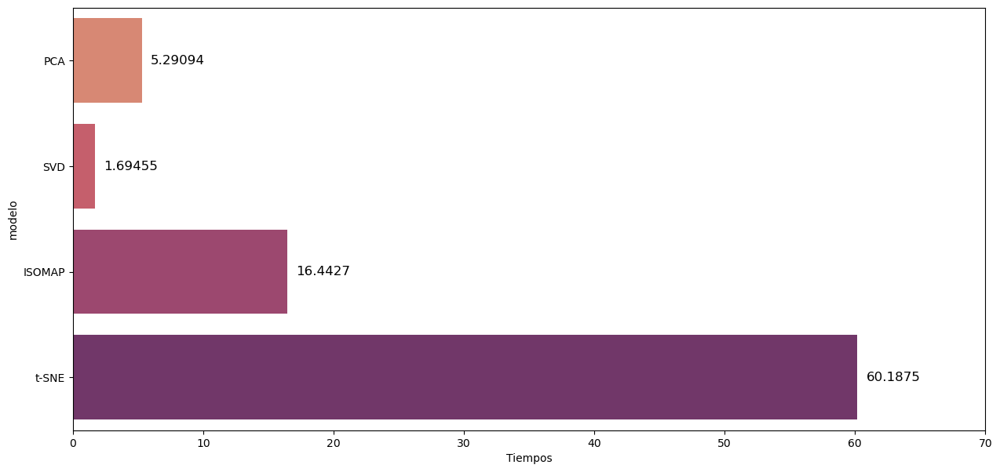

In [37]:
modelo = ["PCA", "SVD", "ISOMAP", "t-SNE"]

time = [timePCA, timeSVD, timetsne, timeISOMAP]

model = pd.DataFrame()
model.insert(0, "modelo", modelo)
model.insert(1, "Tiempos", time)

plot(model, "Tiempos",70)

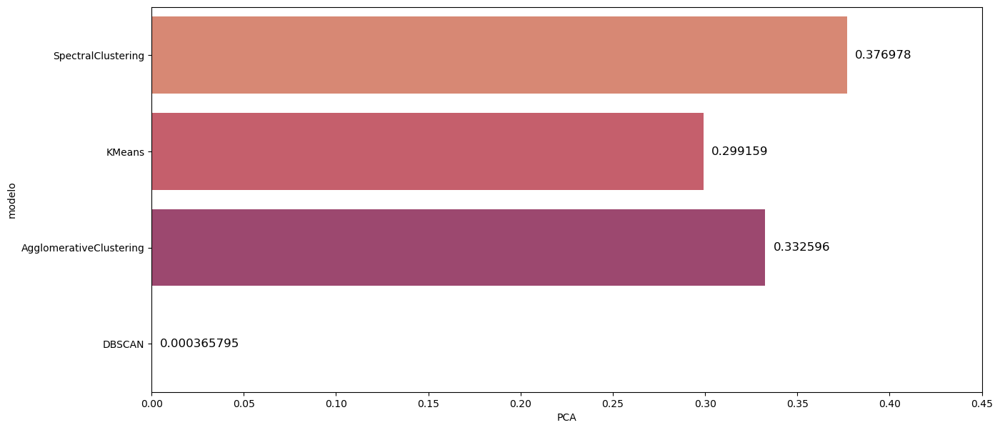

In [38]:
columnas   = ["Reducción Dimensional y Manifold"]
modelos    = ["SpectralClustering", "KMeans", "AgglomerativeClustering", "DBSCAN"]
ariPCA     = [ariSPECPCA, ariKMPCA , ariAggPCA , ariDBSCANPCA]
ariSVD     = [ariSPECSVD , ariKMSVD , ariAggSVD , ariDBSCANSVD]
ariTsne    = [round (ariSPECtsne,0) , ariKMtsne , ariAggtsne , ariDBSCANtsne]
ariIsomap  = [ariSPECISOMAP , ariKMISOMAP , ariAggISOMAP, ariDBSCANISOMAP]


df = pd.DataFrame()
df.insert(0, "modelo", modelos)
df.insert(1, "PCA", ariPCA)
df.insert(2, "SVD", ariSVD)
df.insert(3, "Isomap", ariIsomap)
df.insert(4, "t-SNE", ariTsne)

plot(df, "PCA", 0.45)

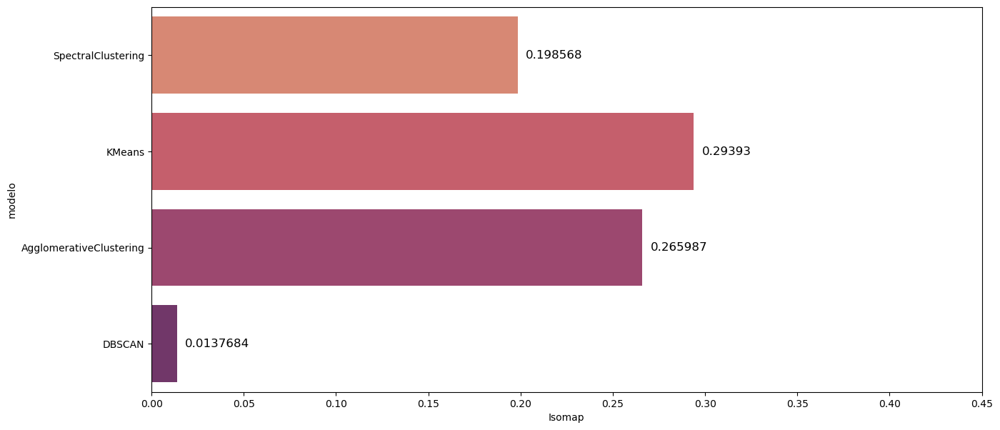

In [39]:
plot(df, "Isomap", 0.45)

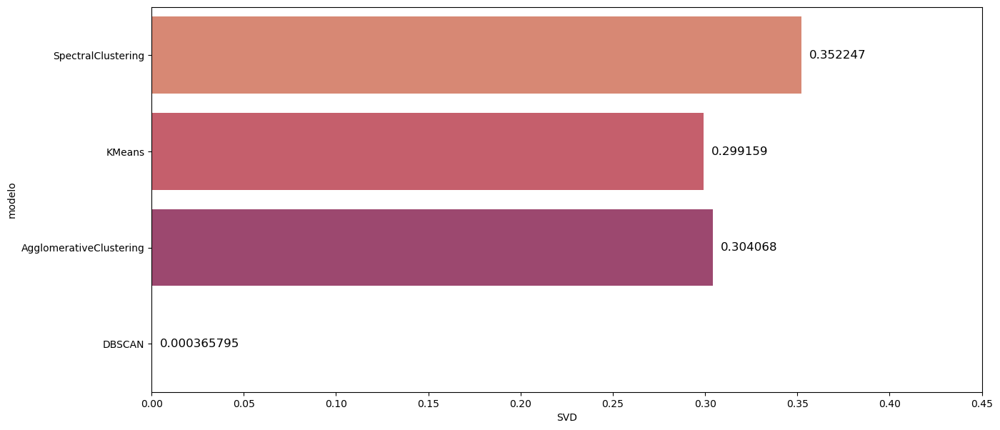

In [40]:
plot (df, "SVD", 0.45)

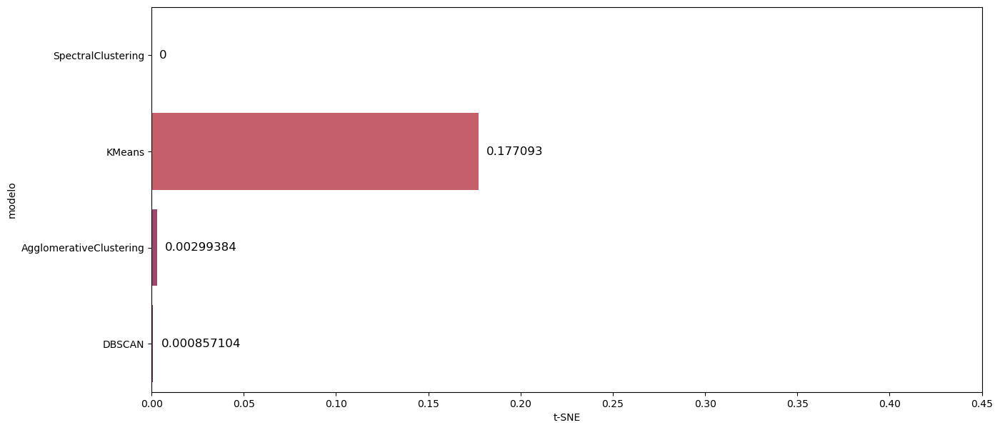

In [41]:
plot (df, "t-SNE", 0.45)

En total estas son los resultados que hemos tenido con cada modelo y algoritmo de reducción dimensional:

In [42]:
df

,modelo,PCA,SVD,Isomap,t-SNE
0,SpectralClustering,0.376978,0.352247,0.198568,0.000000
1,KMeans,0.299159,0.299159,0.293930,0.177093
2,AgglomerativeClustering,0.332596,0.304068,0.265987,0.002994
3,DBSCAN,0.000366,0.000366,0.013768,0.000857


# Entrenaniento y predicción sin reducción

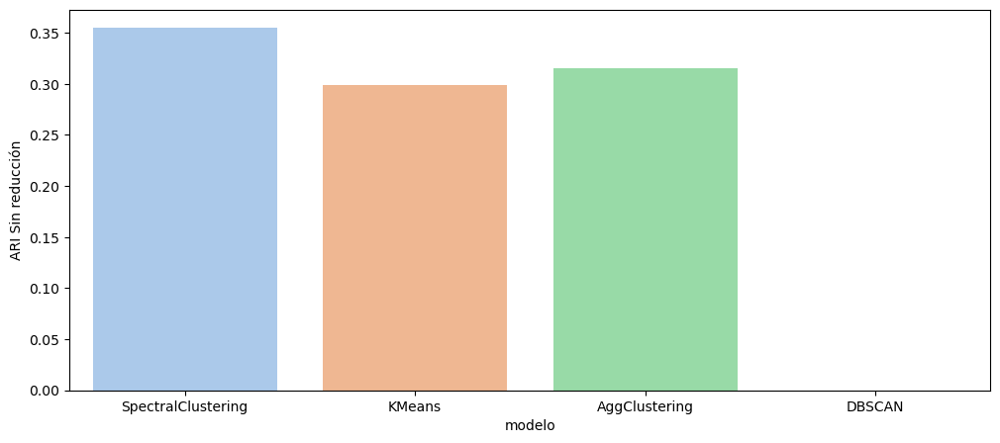

In [43]:
modelos    = ["SpectralClustering", "KMeans", "AggClustering", "DBSCAN"]

_X = [ _.flatten() for _ in X ]
_Y = [ _.flatten() for _ in Y ]


predSinSpec    = predict_spectral(_X, _Y)
ariSinSpec     = adjusted_rand_score(y_clusters, predSinSpec)

predSinKM      = predict_kmeans(_X, _Y)
ariSinKM       = adjusted_rand_score(y_clusters, predSinKM)

predSinAgg     = predict_agglomerative(_X, _Y)
ariSinAgg      = adjusted_rand_score(y_clusters, predSinAgg)

predSinDBS     = predict_DBSCAN(_X, _Y)
ariSinDBS      = adjusted_rand_score(y_clusters, predSinDBS)

ariConPCA  = [ariSPECPCA, ariKMPCA, ariAggPCA, ariDBSCANPCA]

ariConIso  = [ariSPECISOMAP, ariKMISOMAP, ariAggISOMAP, ariDBSCANISOMAP]

ariConSVD  = [ariSPECSVD, ariKMSVD, ariAggSVD, ariDBSCANSVD]

ariConTsne = [ariSPECtsne, ariKMtsne, ariAggtsne, ariDBSCANtsne]

ariSin     = [ariSinSpec, ariSinKM, ariSinAgg, ariSinDBS]


tabla = pd.DataFrame()
tabla.insert(0, "modelo", modelos)
tabla.insert(1, "ARI Sin reducción", ariSin)
tabla.insert(2, "ARI Con PCA", ariConPCA)
tabla.insert(3, "ARI Con ISOMAP", ariConIso)
tabla.insert(4, "ARI Con SVD", ariConSVD)
tabla.insert(5, "ARI Con t-SNE", ariConTsne)


fig0, axs = plt.subplots(1,figsize=(12,5))
axs = sns.barplot (data = tabla, x = "modelo", y = "ARI Sin reducción", palette = "pastel")

<AxesSubplot:xlabel='modelo', ylabel='ARI Con SVD'>

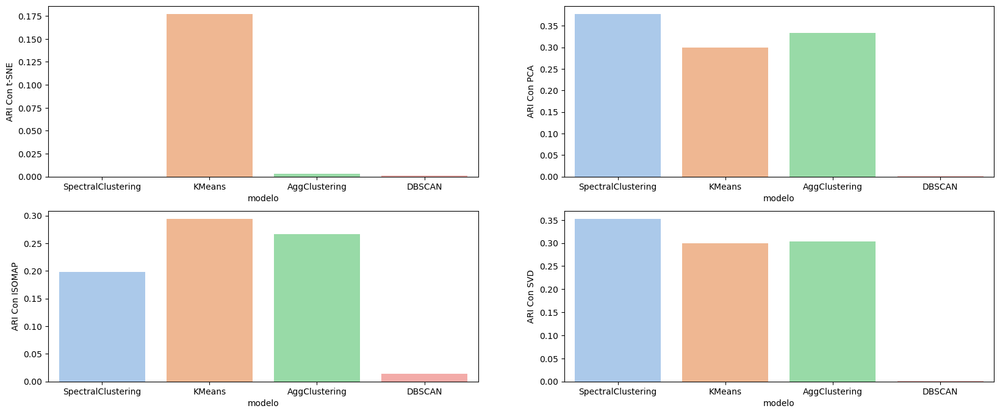

In [44]:
fig0, axs = plt.subplots(2,2,figsize=(20,8))

sns.barplot (data = tabla, x = "modelo", y = "ARI Con t-SNE", ax = axs[0][0], palette = "pastel")
sns.barplot (data = tabla, x = "modelo", y = "ARI Con PCA", ax = axs[0][1], palette = "pastel")
sns.barplot (data = tabla, x = "modelo", y = "ARI Con ISOMAP", ax = axs[1][0], palette = "pastel")
sns.barplot (data = tabla, x = "modelo", y = "ARI Con SVD", ax = axs[1][1], palette = "pastel")

# Mejor predicción obtenida

Esta es la mejor predicción obtenida que como hemos visto ha sido SpectralClustering + PCA con 0.9. Como podemos ver nos da 4 clusters<br>
aunque esté configurada para 5. Conjeturamos que el cluster 2 corresponde a los jokers y que los ha incluido en otra parte al conectar<br>
el grafo mediante Spectral Clustering.

In [45]:
def print_cluster_sizes(pred, y_clusters):
    print("Clusters:")
    for cluster in set(pred):
        print("  ", cluster, "size", len([_ for _ in pred if _ == cluster]))

    print("\nReal clusters:")
    for cluster in set(y_clusters):
        print("  ", cluster, "size", len([_ for _ in y_clusters if _ == cluster]))

    print()

In [46]:
_X, _Y, timePCA = do_pca(X, Y)

predCon = predict_spectral(_X, _Y)
ariCon = adjusted_rand_score(y_clusters, predCon)

print ("ARI de Spectral Clustering + PCA :", ariCon, "\n")
print_cluster_sizes(predCon, y_clusters)

ARI de Spectral Clustering + PCA : 0.37697808574513936 

Clusters:
   0 size 130
   1 size 120
   3 size 3
   4 size 12

Real clusters:
   0 size 65
   1 size 65
   2 size 65
   3 size 65
   4 size 5



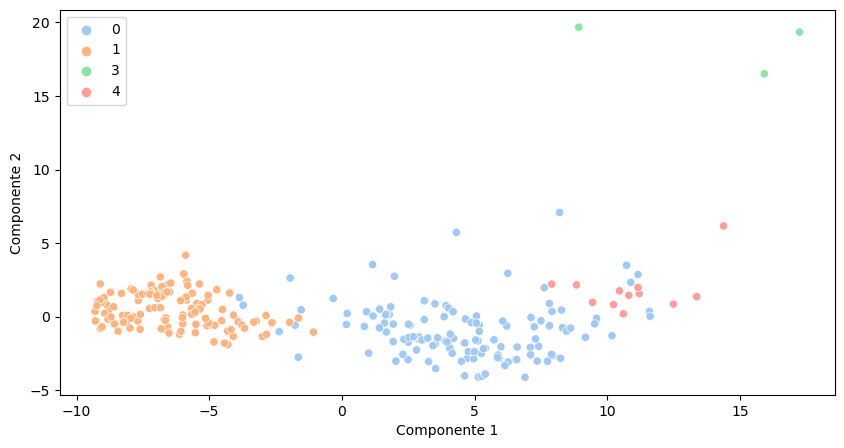

In [47]:
display(HTML('<h3>Nubes de clusters predichos después de clustering</h3><br>'))
plot_cluster_clouds([_.flatten()/255 for _ in Y], predCon)

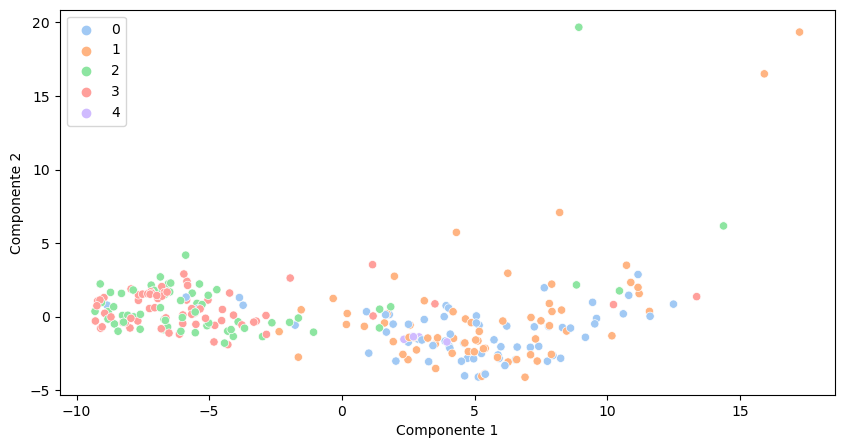

In [48]:
display(HTML('<h3>Nubes de clusters reales después de clustering</h3><br>'))
plot_cluster_clouds([_.flatten()/255 for _ in Y], y_clusters)

Podemos ver que la forma es bastante parecida pero el algoritmo asume que los clusters están bastante cerca.

Y esta es la clasificación final de imágenes:

In [49]:
def draw_clusters(imgs, pred):
    figheights = { 0: 0, 1: 5, 2: 7, 3: 10, 4: 15, 5: 16, 6: 20, 7: 25, 8: 28, 9: 30, 10: 35, 11: 40, 12: 45, 13: 50 }
    
    for targetClusterN in range(5):
        if targetClusterN in pred:
            cluster_size = len([_ for _ in pred if _ == targetClusterN])
            nrows = cluster_size//10 + (1 if cluster_size%10 != 0 else 0)

            fig, axs = plt.subplots(ncols=10, nrows=nrows, figsize=(30, figheights[nrows]))
            fig.tight_layout()
            plt.figure(constrained_layout=True)

            # ax que va a tener el titulo
            title_ax = axs[0][0] if nrows > 1 else axs[0]
            title_ax.set_title("\nCluster " + str(targetClusterN) + "\n", fontsize=15)

            y, x = 0, 0

            for i, clusterN in enumerate(pred):
                if clusterN == targetClusterN:
                    img = cv2.cvtColor(imgs[i], cv2.COLOR_BGR2RGB)
                    
                    if nrows > 1: axs[y][x].imshow(img, aspect="auto")
                    else: axs[x].imshow(img, aspect="auto")

                    x += 1

                if x == 10:
                    x = 0
                    y += 1

También podemos ver que al final ha acabado clasificando las cartas por el color de su palo, lo cual tiene sentido porque<br>
generalmente los tréboles y picas (y jokers) son negros, mientras que los diamantes y corazones son rojos, por lo que dado un<br>
número suficientemente grande de cartas podemos suponer que acertará alrededor del 50% de las veces. Si a esto le añadimos<br>
el ruido de las cartas y el cambio de color de background, los angulos etc. que aumentarían el error, el resultado que hemos<br>
obtenido parece bastante razonable.

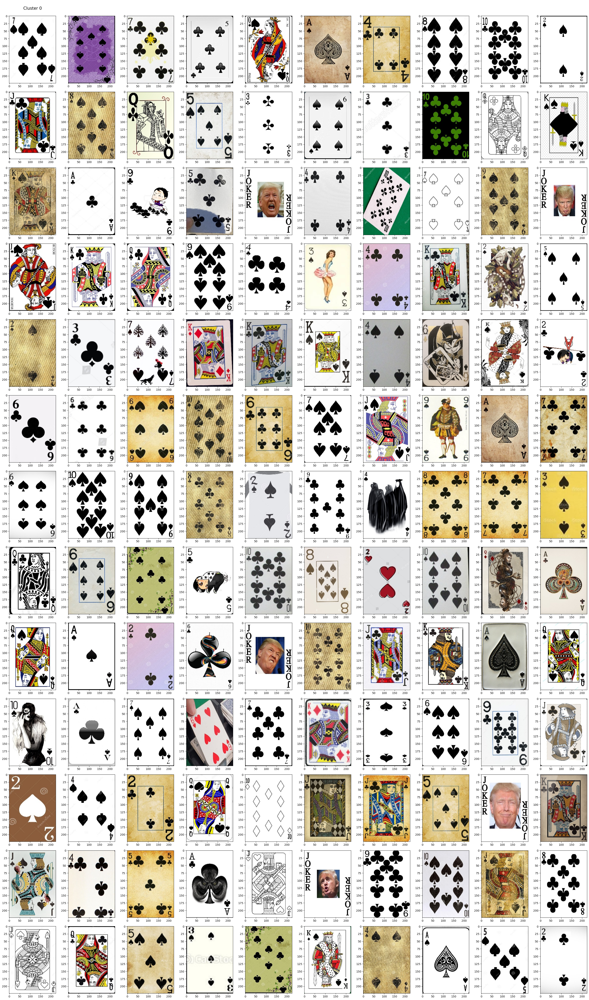

<Figure size 640x480 with 0 Axes>

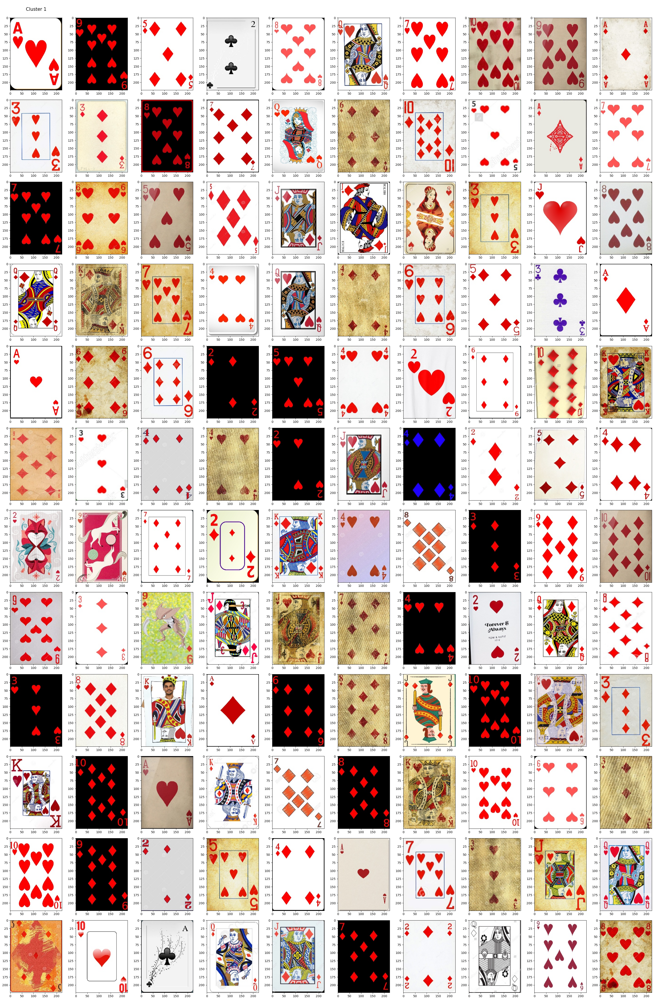

<Figure size 640x480 with 0 Axes>

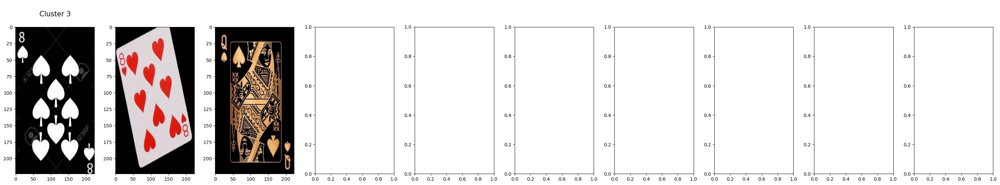

<Figure size 640x480 with 0 Axes>

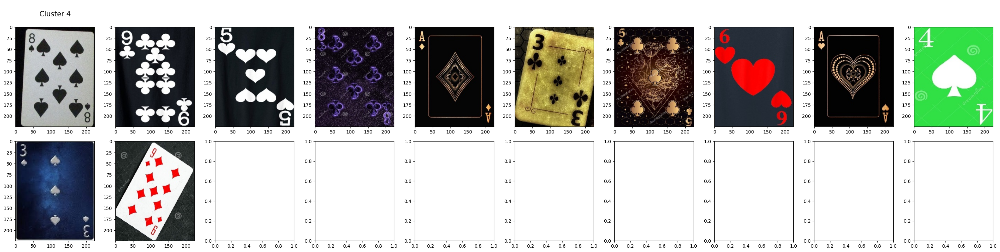

<Figure size 640x480 with 0 Axes>

In [50]:
draw_clusters(Y_orig, predCon)

---

<center><h2>Conclusiones</h2></center>

---

Esta ha sido una práctica bastante diferente a las anteriores. En las anteriores prácticas contabamos con datos estructurados en CSV conociendo<br>
cuales eran los valores que el modelo debería tener como referencia para las predicciones. En este caso contabamos con datos no estructurados<br>
en forma de imágenes y además teníamos la restricción de entrenar el modelo de forma no supervisada.

Ha habido momentos en los cuales no sabíamos como seguir y viendo el resultado de la transformación de imágenes, no nos parece intuitivo que el<br>
modelo sea capaz de dividir las imágenes mejor mediante el resultado de la transformación que con la carta original, pero que al final acabó<br>
funcionando mejor.

También comentar que identificamos las cartas del conjunto de test para calcular el ARI, lo cual no sería posible en un caso real no supervisado<br>
ya que el entrenamiento no supervisado se usa entre otras cosas para buscar clasificaciones alternativas de objetos. También podemos pensar en el<br>
caso donde no sepamos clasificar las imagenes nosotros. En principio pensabamos que era actualmente lo que había que hacer y al comentarselo a los dos<br>
profesores de la asignatura, ninguno nos dijo que fuera incorrecto.

En general nuestro procedimiento para esta práctica ha sido el siguiente:<br>

* 1. Hacer transformación de imágenes
* 2. Probar con kmeans como referencia
* 3. Visualizar la categorización del modelo y analizar como podríamos mejorarlo
* 4. Probar con otros métodos de clustering
* 5. Hacer nuevas transformaciones de imagenes y data augmentation
* 6. Hacer búsqueda de parámetros para las transformaciones
* 7. Intentar usar algoritmos de reducción dimensional con diferentes varianzas
* 8. Intentar otros métodos de clustering
* 9. Hacer búsqueda de hiperparámetros de dichos métodos de clustering
* 10. Volver a punto 3

En general hemos intentado hacer transformaciones que fuesen intuitivas para nosotros pero hemos podido ver que no siempre han sido las que<br>
han sido más adecuadas para este problema.